In [11]:
import pandas as pd
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import train_test_split
import numpy as np


In [12]:
df = pd.read_csv('msd_genre_dataset.txt')

In [3]:
df_relevant_features = df.drop(columns=["track_id", "artist_name", "title"])

X = df_relevant_features
# X = df_relevant_features.drop(columns=['genre'])
# X = df_relevent_features.drop(columns=['key'])
# print(X.head())
label_encoder = LabelEncoder()
X['genre'] = label_encoder.fit_transform(df_relevant_features['genre'])

X_mode = pd.get_dummies(df_relevant_features, columns=['mode'])
X_key = pd.get_dummies(df_relevant_features, columns=['key'])
X_time = pd.get_dummies(df_relevant_features, columns=['time_signature'])

# X['genre'] = label_encoder.fit_transform(df_relevant_features['genre'])
# X['genre'] = np.float64(X['genre'])
# X = X.get_dummies(X, columns=['time_signature', 'mode'])
# print(X.head())

y = label_encoder.fit_transform(df_relevant_features['genre'])

In [4]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, random_state=16, shuffle=True)

                                             |          | [  0%]   00:00 -> (? left)


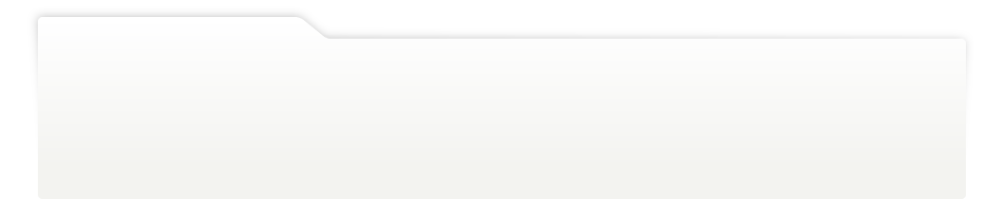
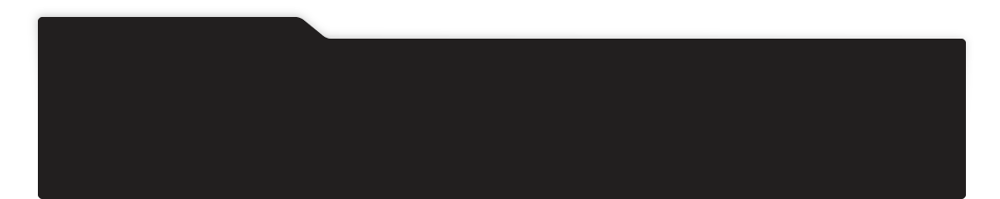
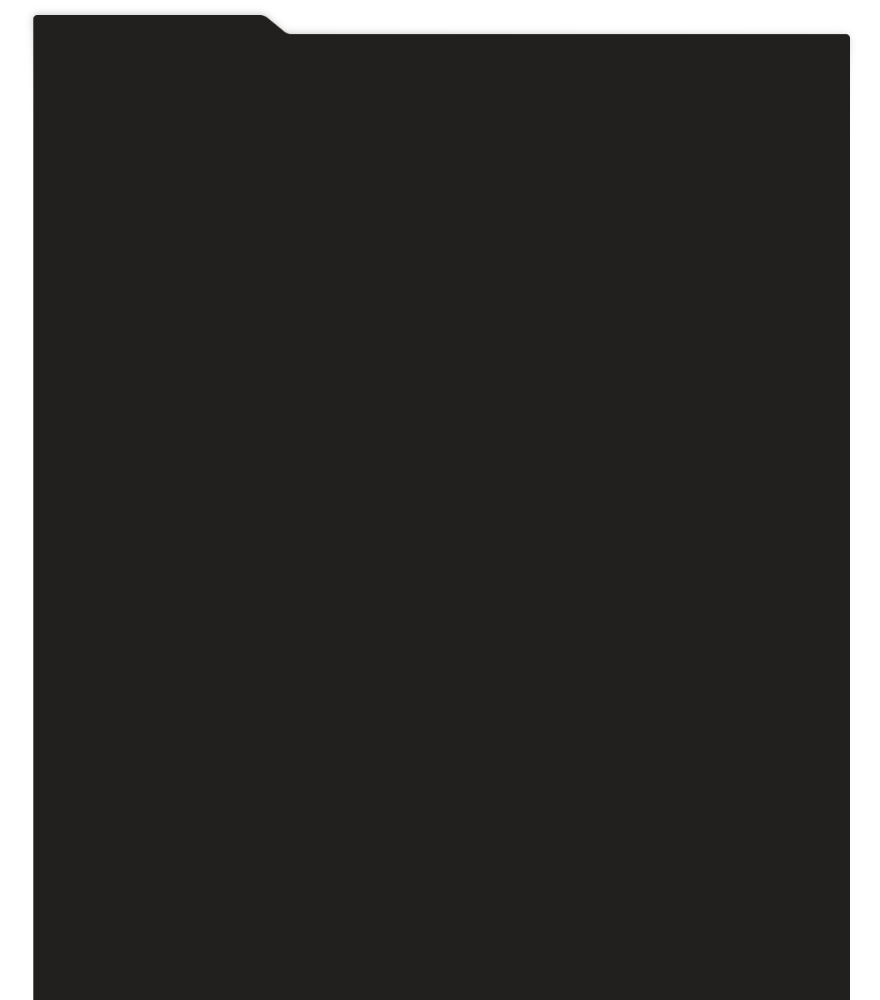
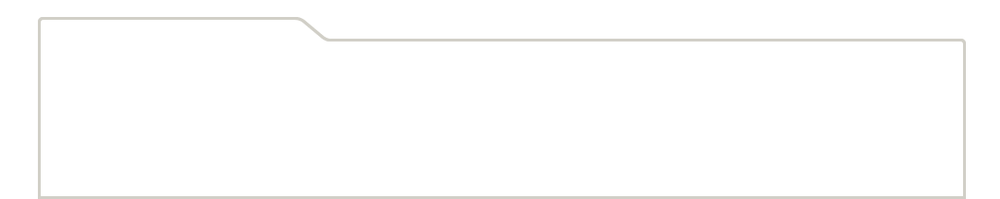
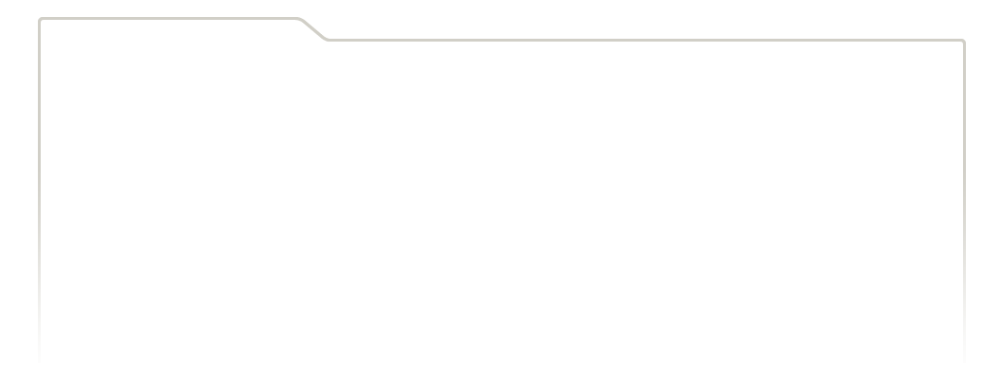
...
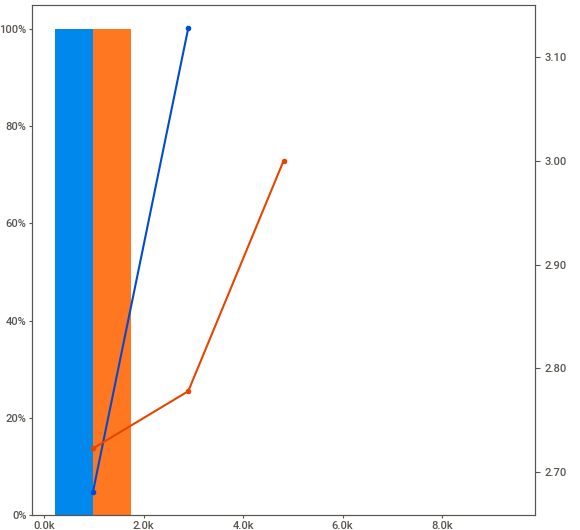
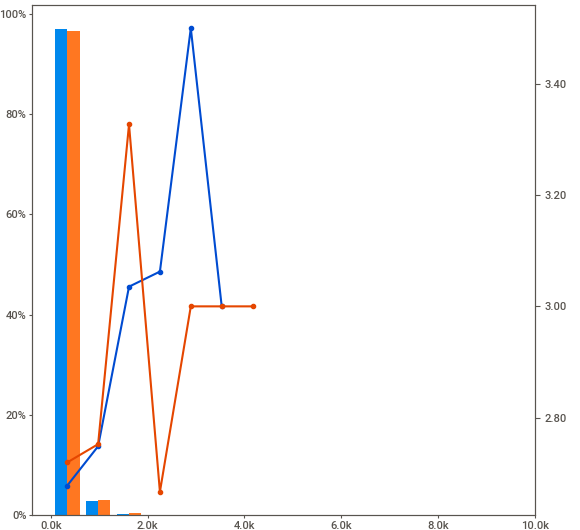
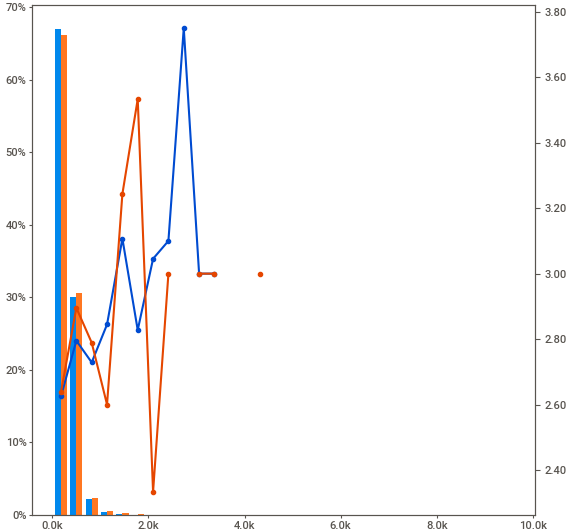
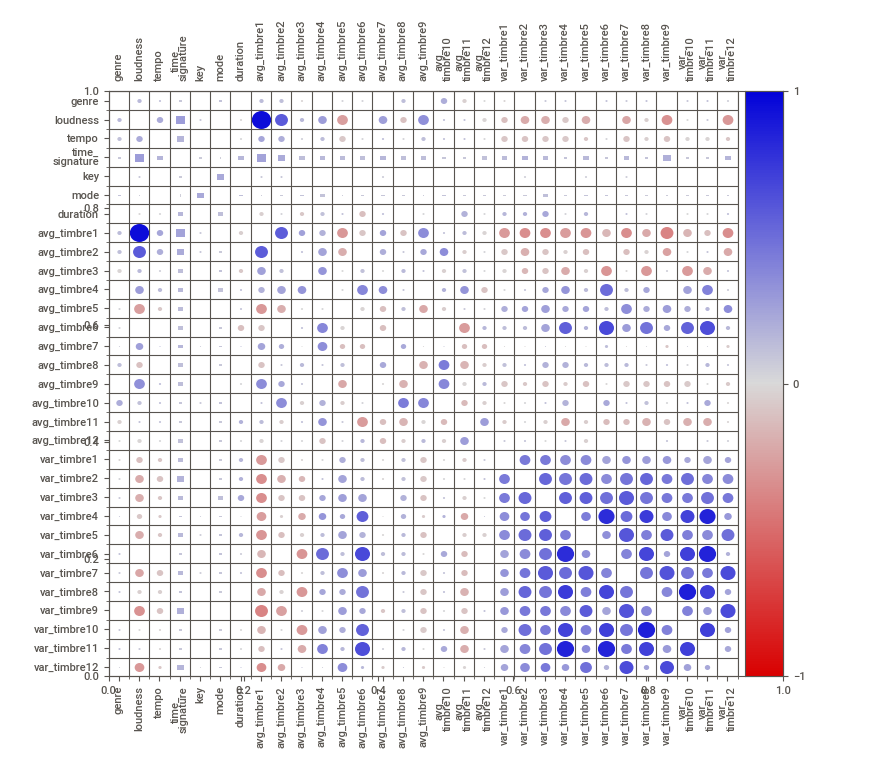
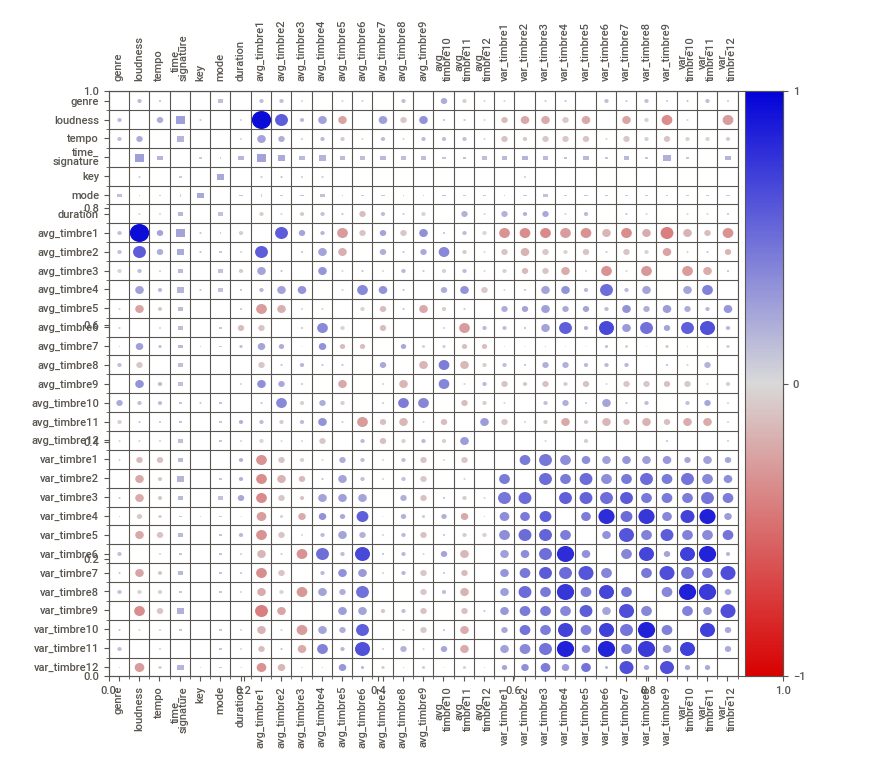

In [5]:
import sweetviz as sv


#analyzing the dataset
comparison_report = sv.compare([X_train, "Train"], [X_test, "Test"], target_feat="genre", feat_cfg=sv.FeatureConfig(force_num=['genre']))
comparison_report.show_notebook()

In [6]:
print(comparison_report.get_what_influences_me('genre'))

{'loudness': 0.10521807850175757, 'tempo': 0.06811739105096073, 'key': 0.00947956194724591, 'duration': 0.021339613966367944, 'avg_timbre1': 0.09302201068247054, 'avg_timbre2': 0.07524819578042097, 'avg_timbre3': -0.06819786804582674, 'avg_timbre4': -0.014919857579283671, 'avg_timbre5': -0.026039633670164535, 'avg_timbre6': -0.02232457582825379, 'avg_timbre7': 0.017203475878092258, 'avg_timbre8': 0.0796014875126026, 'avg_timbre9': 0.014186608234830944, 'avg_timbre10': 0.16735650447657774, 'avg_timbre11': -0.08426825425086466, 'avg_timbre12': -0.043545632813116915, 'var_timbre1': -0.05935407477896237, 'var_timbre2': -0.024363071275123518, 'var_timbre3': 0.025462337036163178, 'var_timbre4': 0.04410760660536351, 'var_timbre5': 0.01255248349005442, 'var_timbre6': 0.049806341951276395, 'var_timbre7': 0.02254032399151824, 'var_timbre8': 0.04635699200268622, 'var_timbre9': -0.010757280857945943, 'var_timbre10': 0.033441540605454664, 'var_timbre11': 0.05831034985006235, 'var_timbre12': -0.0024

In [14]:
# Standardize data
from sklearn.preprocessing import StandardScaler

df_relevant_features = df.drop(columns=["track_id", "artist_name", "title"])

# X = df_relevant_features
X = df_relevant_features.drop(columns=['genre'])
# X = df_relevent_features.drop(columns=['key'])
# print(X.head())
label_encoder = LabelEncoder()
standardizer = StandardScaler()

X_mode = pd.get_dummies(df_relevant_features, columns=['mode'])
X_key = pd.get_dummies(df_relevant_features, columns=['key'])
X_time = pd.get_dummies(df_relevant_features, columns=['time_signature'])

# X['genre'] = label_encoder.fit_transform(df_relevant_features['genre'])
# X['genre'] = np.float64(X['genre'])
# X = X.get_dummies(X, columns=['time_signature', 'mode'])
# print(X.head())

y = df_relevant_features['genre']
y = label_encoder.fit_transform(y)
std_X = standardizer.fit_transform(X)
# std_X['genre'] = label_encoder.fit_transform(df_relevant_features['genre'])


{'loudness': 0.10521807850175752, 'tempo': 0.0681173910509607, 'key': 0.009479561947245899, 'duration': 0.02133961396636794, 'avg_timbre1': 0.09302201068247046, 'avg_timbre2': 0.07524819578042091, 'avg_timbre3': -0.0681978680458267, 'avg_timbre4': -0.014919857579283656, 'avg_timbre5': -0.026039633670164538, 'avg_timbre6': -0.022324575828253784, 'avg_timbre7': 0.01720347587809225, 'avg_timbre8': 0.07960148751260254, 'avg_timbre9': 0.014186608234830932, 'avg_timbre10': 0.16735650447657766, 'avg_timbre11': -0.08426825425086461, 'avg_timbre12': -0.04354563281311688, 'var_timbre1': -0.05935407477896234, 'var_timbre2': -0.024363071275123525, 'var_timbre3': 0.025462337036163168, 'var_timbre4': 0.04410760660536348, 'var_timbre5': 0.012552483490054413, 'var_timbre6': 0.0498063419512764, 'var_timbre7': 0.022540323991518223, 'var_timbre8': 0.04635699200268618, 'var_timbre9': -0.01075728085794593, 'var_timbre10': 0.03344154060545464, 'var_timbre11': 0.05831034985006232, 'var_timbre12': -0.00241886

In [15]:
expanded_y = y[:, np.newaxis]

In [16]:
full_std_X = np.concatenate([expanded_y, std_X], axis=1)

In [17]:
X_train, X_test, y_train, y_test = train_test_split(full_std_X, y, test_size=0.25, random_state=16, shuffle=True)

In [11]:
X_train = pd.DataFrame(X_train, columns=df_relevant_features.columns)
X_test = pd.DataFrame(X_train, columns=df_relevant_features.columns)

                                             |          | [  0%]   00:00 -> (? left)


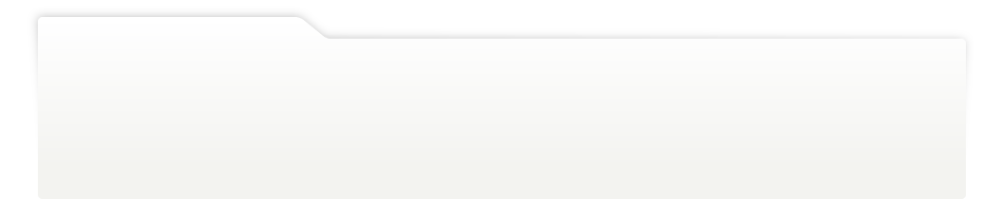
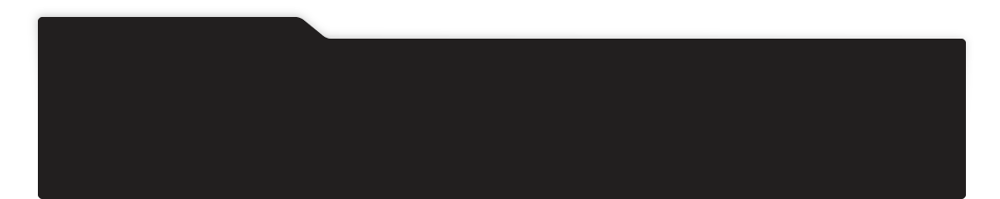
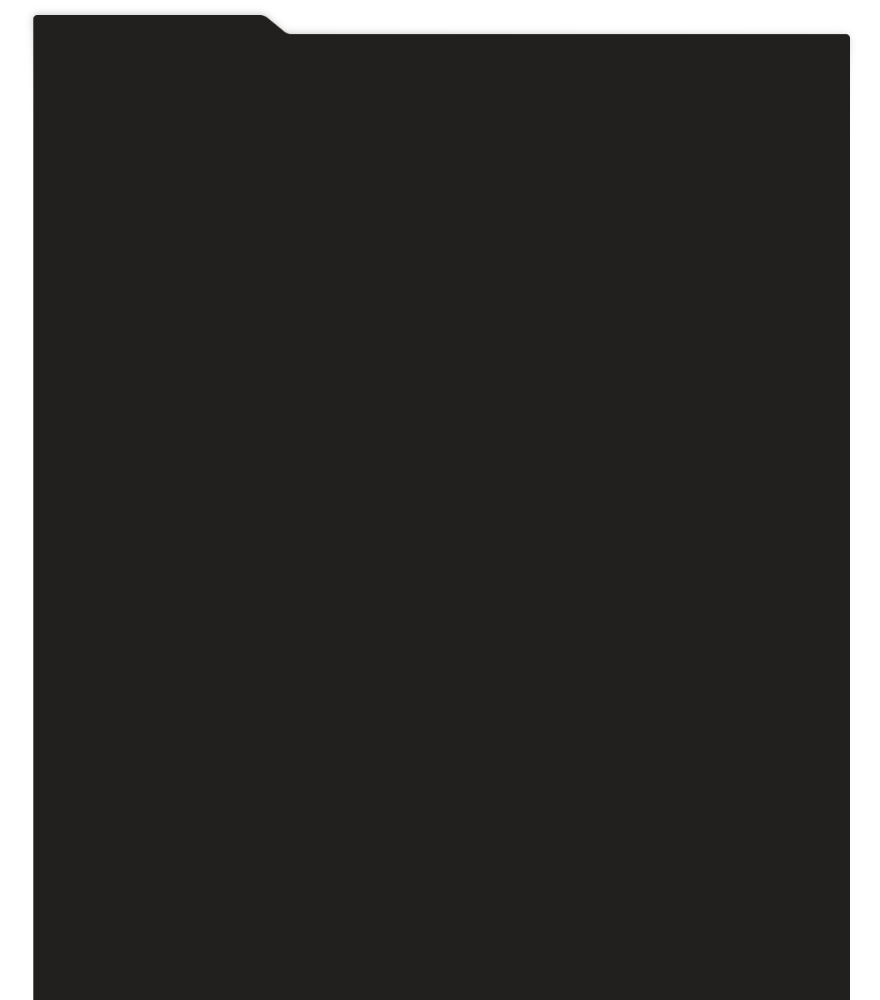
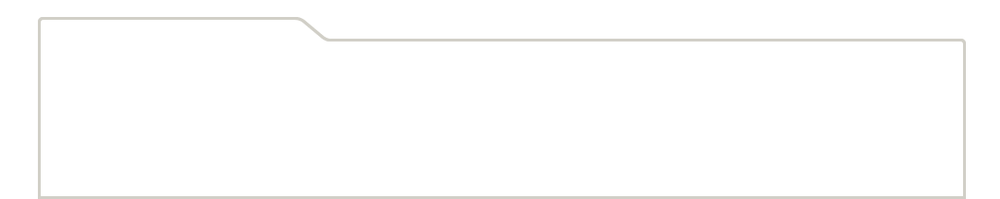
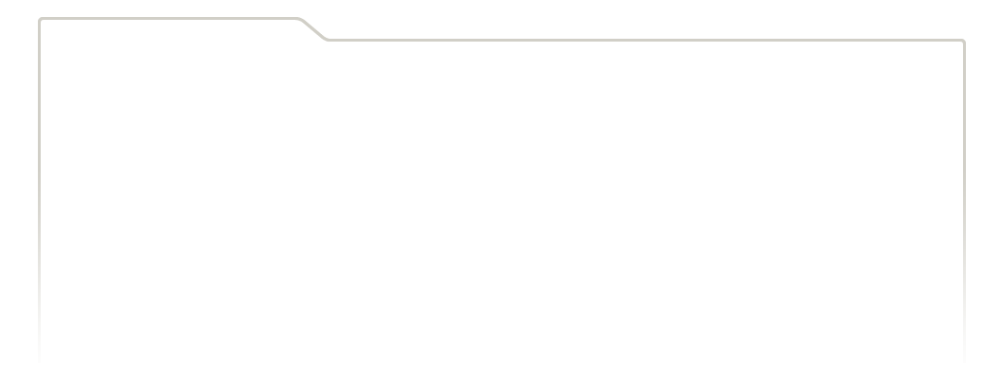
...
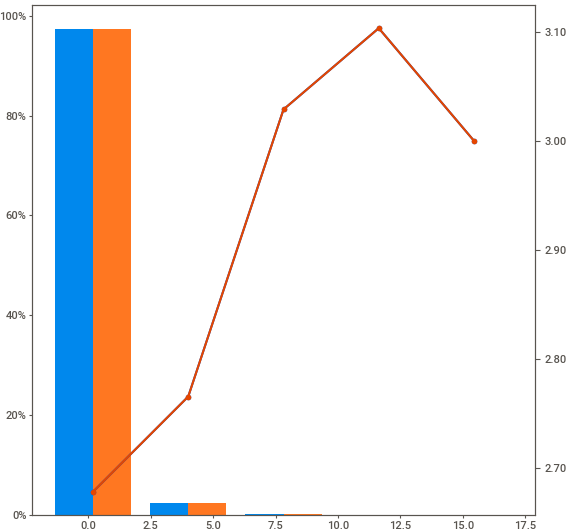
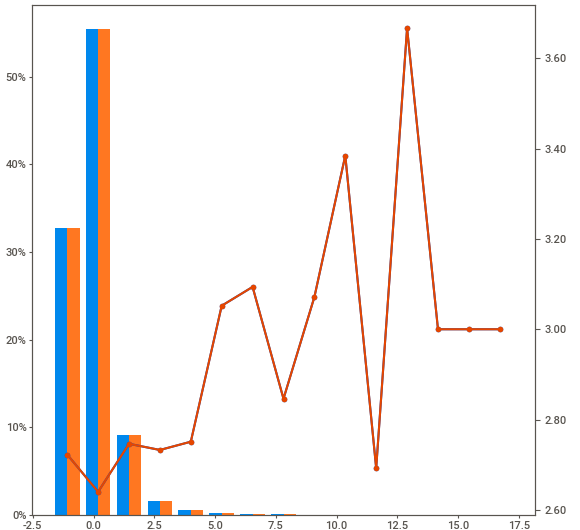
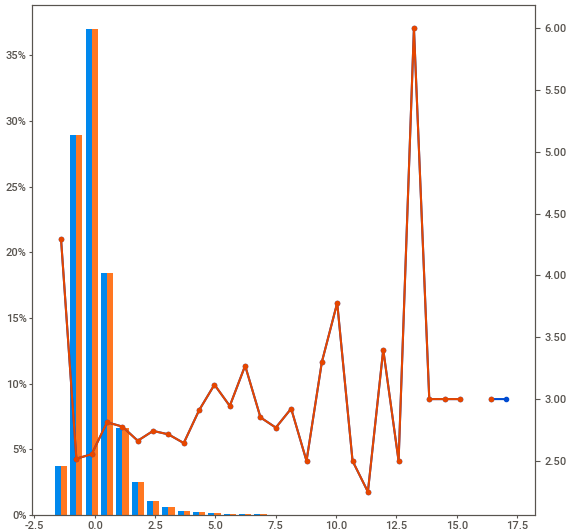
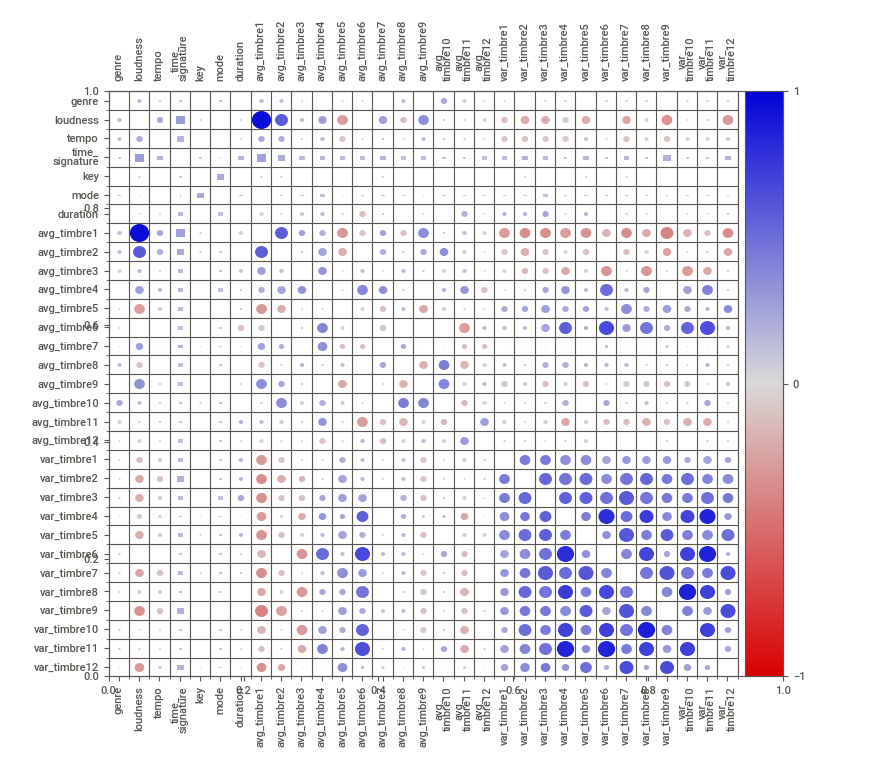
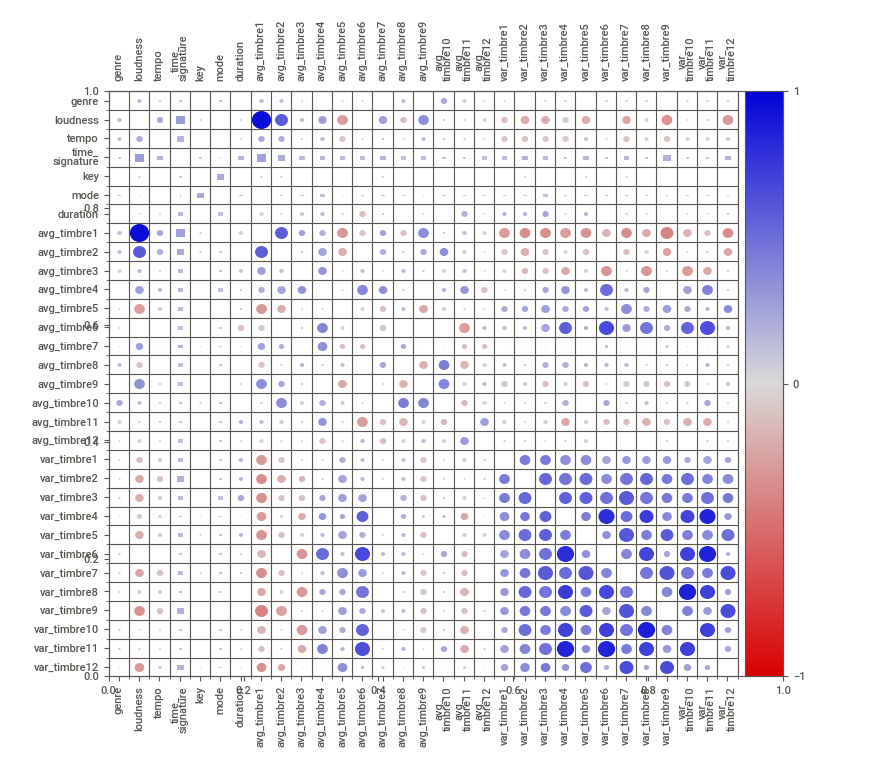

In [12]:
import sweetviz as sv

#analyzing the dataset
comparison_report = sv.compare([X_train, "Train"], [X_test, "Test"], target_feat="genre", feat_cfg=sv.FeatureConfig(force_num=['genre']))
comparison_report.show_notebook()

In [18]:
from imblearn.over_sampling import SMOTE

smote = SMOTE()

std_X = pd.DataFrame(std_X, columns=df_relevant_features.columns[1:])

sampled_X, sampled_y = smote.fit_resample(X,y)

In [19]:
std_X = standardizer.fit_transform(sampled_X)
expanded_y = sampled_y[:, np.newaxis]

std_X = np.concatenate([expanded_y, std_X], axis=1)

sampled_X = pd.DataFrame(std_X, columns=df_relevant_features.columns)

sampled_X['genre'] = sampled_y

In [20]:
X_train, X_test, y_train, y_test = train_test_split(sampled_X, sampled_y, test_size=0.25, random_state=16, shuffle=True)

In [29]:
sampled_X

,genre,loudness,tempo,time_signature,key,mode,duration,avg_timbre1,avg_timbre2,avg_timbre3,...,var_timbre3,var_timbre4,var_timbre5,var_timbre6,var_timbre7,var_timbre8,var_timbre9,var_timbre10,var_timbre11,var_timbre12
0,0,0.391728,0.966045,-2.018902,1.276723,1.037158,-0.093746,0.708353,0.341321,0.166595,...,-0.674611,-0.959278,-0.778351,-0.592558,-1.029283,-0.681201,-0.876937,-0.856788,-0.647439,-1.014079
1,0,0.068592,0.766783,-2.018902,-0.329119,-0.964173,-0.530325,0.284650,-1.568257,0.927365,...,-0.127881,-0.544024,-0.806226,-0.611914,-0.445044,-0.432862,-0.263868,-0.556475,-0.564084,-0.405574
2,0,-0.398325,-0.315623,-2.018902,1.597891,-0.964173,-0.774437,-0.565060,-1.078736,0.573004,...,-0.711434,0.972978,-0.491227,-0.438954,-0.365540,-0.309016,0.299591,-0.397028,0.734387,-0.403730
3,0,-0.281720,-0.178012,0.552912,0.634386,1.037158,-0.063686,0.133685,0.390099,1.285808,...,-0.998633,-0.973724,-1.008668,-0.929207,-0.871485,-0.965331,-0.813914,-0.964544,-1.151144,0.131483
4,0,-0.496979,0.555922,0.552912,1.276723,-0.964173,0.375313,-0.088839,-0.187315,0.884540,...,-0.792245,-1.171163,-0.144863,-1.203153,-1.082722,-1.134921,0.085028,-1.115190,-1.173142,-0.668402
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
238945,9,0.717950,-1.067876,0.552912,0.313218,1.037158,-0.080207,0.400010,0.086150,-1.018809,...,-0.018088,0.278494,0.055423,0.498140,-0.056122,1.009069,0.869805,1.004079,0.361986,-0.358057
238946,9,0.258545,-0.898415,0.552912,0.313218,-0.964173,-0.475305,0.173133,-0.825689,-0.313633,...,-0.243545,0.793205,-0.079328,0.921357,1.015471,0.990751,0.340918,1.240404,0.350054,0.544513
238947,9,0.457516,2.308320,0.552912,-0.329119,-0.964173,-0.294748,0.298317,0.774648,-0.716977,...,0.309612,0.569293,0.366061,0.615041,1.895011,2.736707,2.026429,1.824800,1.381002,1.032098
238948,9,0.955999,-0.244748,0.552912,0.634386,-0.964173,-0.227625,0.551342,0.375792,-0.573244,...,-0.380048,0.966299,-0.249703,1.340031,0.399160,0.311576,-0.378866,0.106857,0.700201,-0.168509


                                             |          | [  0%]   00:00 -> (? left)


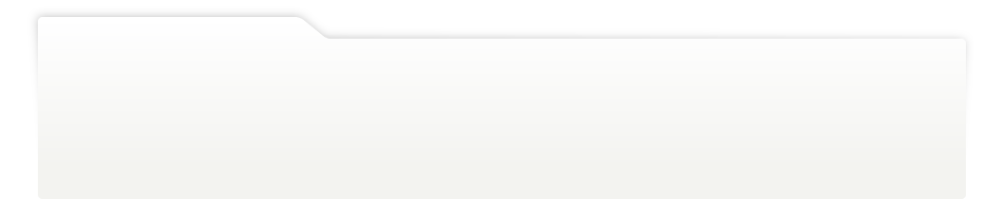
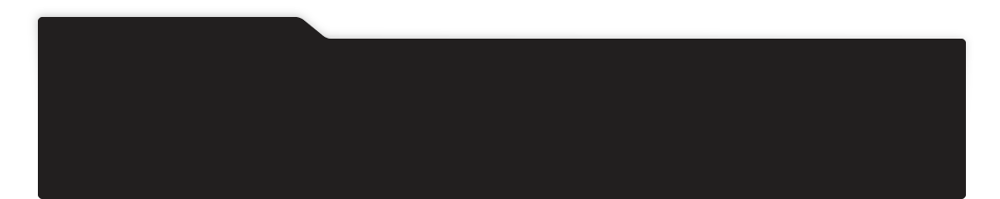
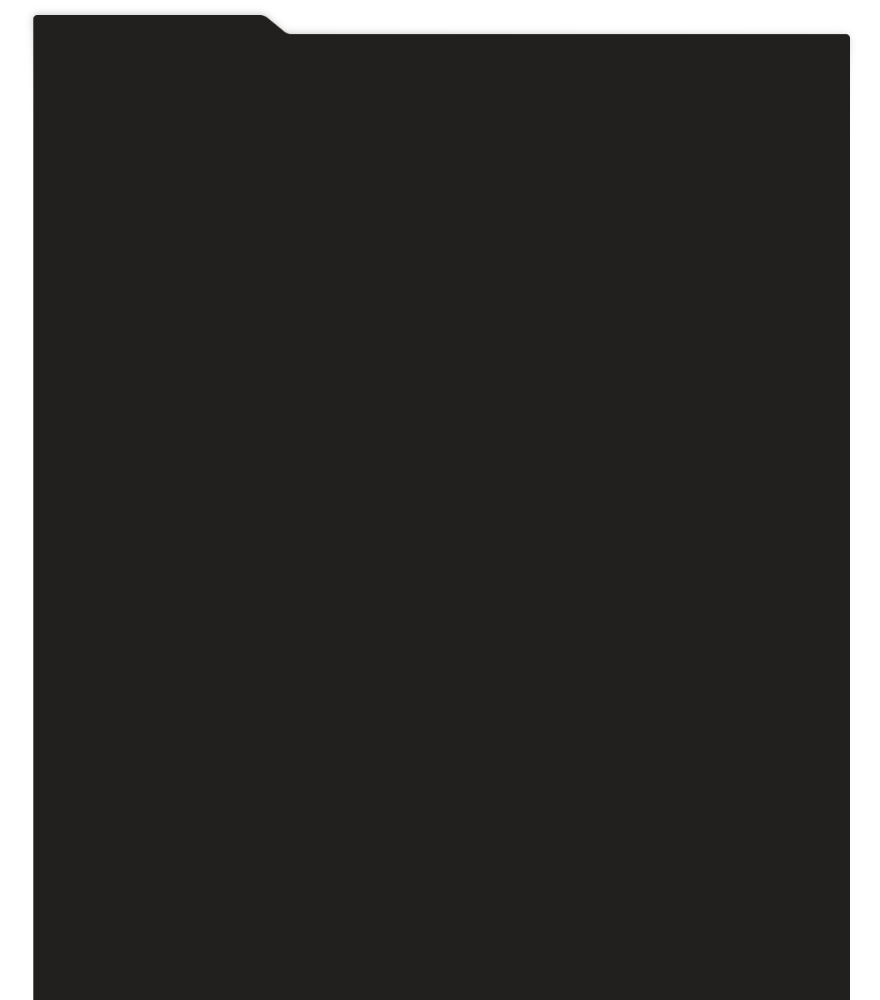
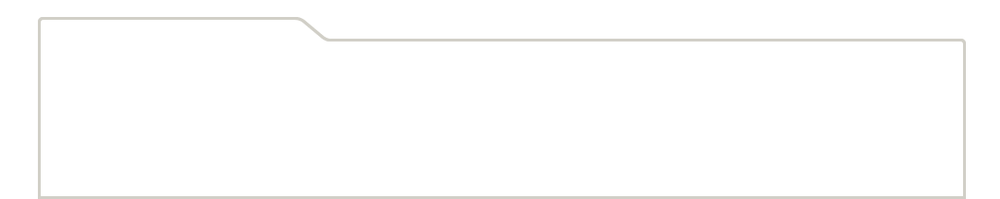
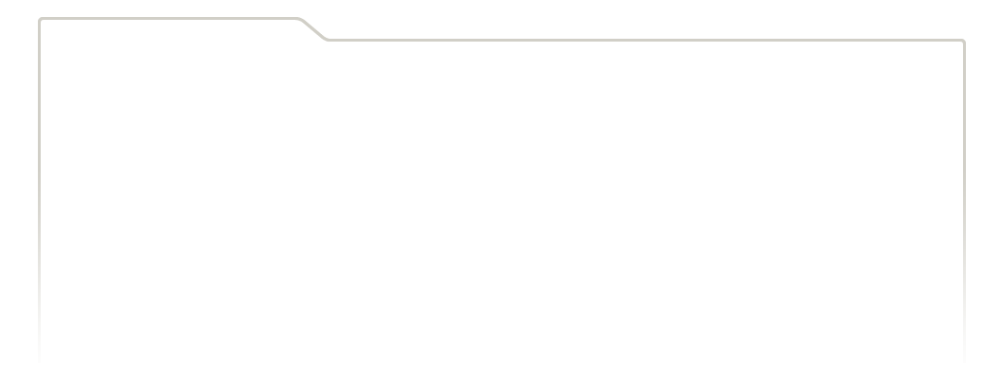
...
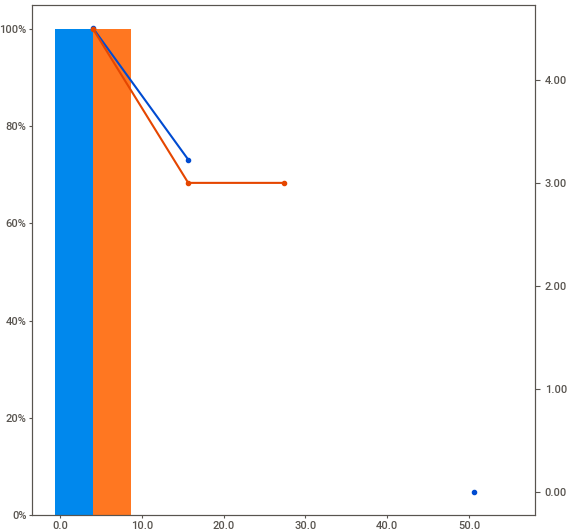
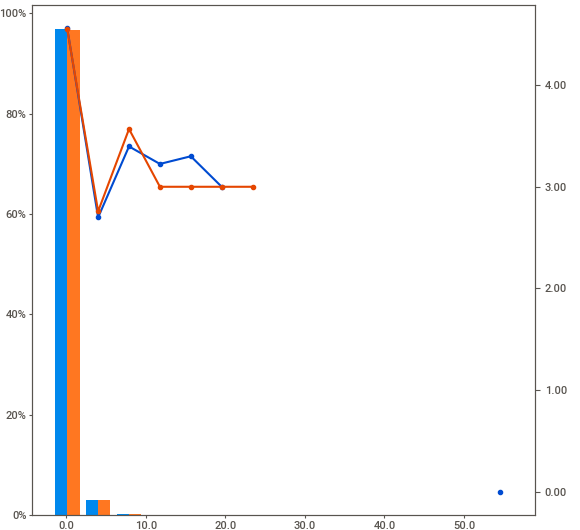
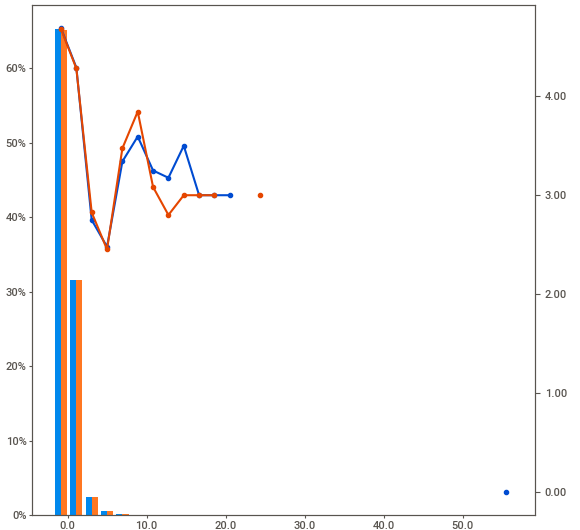
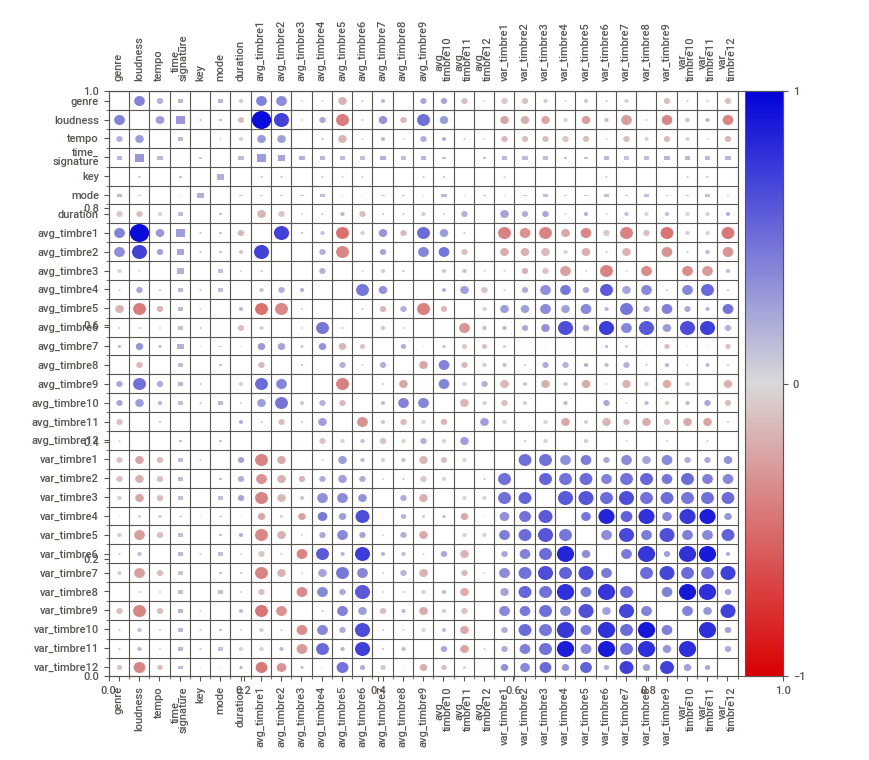
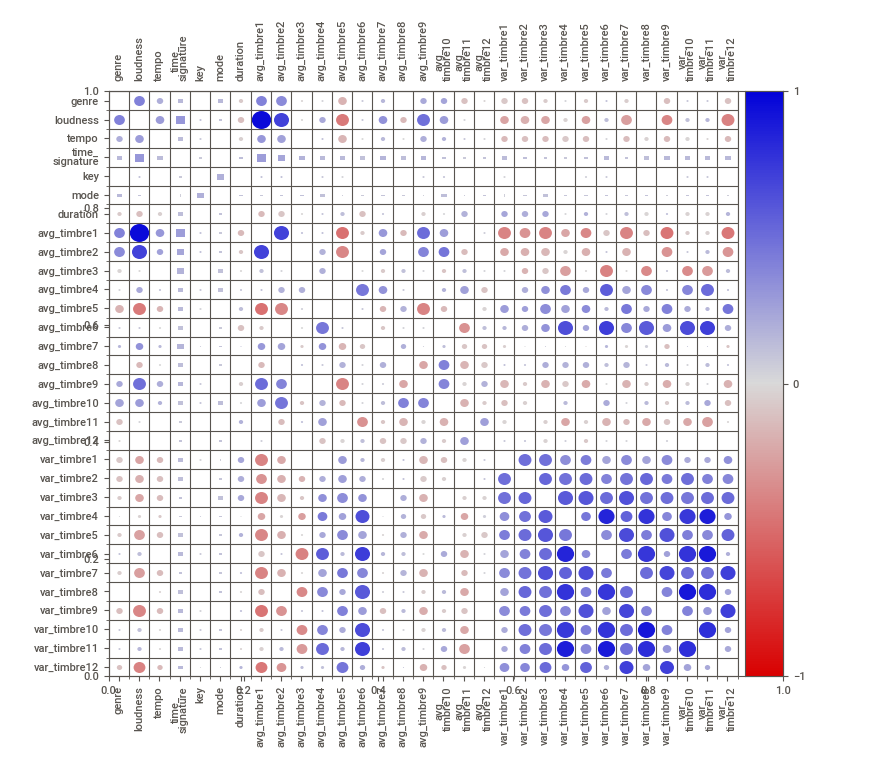

In [21]:
import sweetviz as sv

#analyzing the dataset
comparison_report = sv.compare([X_train, "Train"], [X_test, "Test"], target_feat="genre", feat_cfg=sv.FeatureConfig(force_num=['genre']))
comparison_report.show_notebook()

In [41]:
sampled_X.columns

Index(['genre', 'loudness', 'tempo', 'time_signature', 'key', 'mode',
       'duration', 'avg_timbre1', 'avg_timbre2', 'avg_timbre3', 'avg_timbre4',
       'avg_timbre5', 'avg_timbre6', 'avg_timbre7', 'avg_timbre8',
       'avg_timbre9', 'avg_timbre10', 'avg_timbre11', 'avg_timbre12',
       'var_timbre1', 'var_timbre2', 'var_timbre3', 'var_timbre4',
       'var_timbre5', 'var_timbre6', 'var_timbre7', 'var_timbre8',
       'var_timbre9', 'var_timbre10', 'var_timbre11', 'var_timbre12'],
      dtype='object')

In [43]:
std_dev_limit = 5

new_dfs = sampled_X.query(f"-{std_dev_limit} <= loudness <= {std_dev_limit} &\
                          -{std_dev_limit} <= tempo <= {std_dev_limit} &\
                          -{std_dev_limit} <= time_signature <= {std_dev_limit} &\
                          -{std_dev_limit} <= key <= {std_dev_limit} &\
                          -{std_dev_limit} <= mode <= {std_dev_limit} &\
                          -{std_dev_limit} <= duration <= {std_dev_limit} &\
                          -{std_dev_limit} <= avg_timbre1 <= {std_dev_limit} &\
                          -{std_dev_limit} <= avg_timbre2 <= {std_dev_limit} &\
                          -{std_dev_limit} <= avg_timbre3 <= {std_dev_limit} &\
                          -{std_dev_limit} <= avg_timbre4 <= {std_dev_limit} &\
                          -{std_dev_limit} <= avg_timbre5 <= {std_dev_limit} &\
                          -{std_dev_limit} <= avg_timbre6 <= {std_dev_limit} &\
                          -{std_dev_limit} <= avg_timbre7 <= {std_dev_limit} &\
                          -{std_dev_limit} <= avg_timbre8 <= {std_dev_limit} &\
                          -{std_dev_limit} <= avg_timbre9 <= {std_dev_limit} &\
                          -{std_dev_limit} <= avg_timbre10 <= {std_dev_limit} &\
                          -{std_dev_limit} <= avg_timbre11 <= {std_dev_limit} &\
                          -{std_dev_limit} <= avg_timbre12 <= {std_dev_limit} &\
                          -{std_dev_limit} <= var_timbre1 <= {std_dev_limit} &\
                          -{std_dev_limit} <= var_timbre2 <= {std_dev_limit} &\
                          -{std_dev_limit} <= var_timbre3 <= {std_dev_limit} &\
                          -{std_dev_limit} <= var_timbre4 <= {std_dev_limit} &\
                          -{std_dev_limit} <= var_timbre5 <= {std_dev_limit} &\
                          -{std_dev_limit} <= var_timbre6 <= {std_dev_limit} &\
                          -{std_dev_limit} <= var_timbre7 <= {std_dev_limit} &\
                          -{std_dev_limit} <= var_timbre8 <= {std_dev_limit} &\
                          -{std_dev_limit} <= var_timbre9 <= {std_dev_limit} &\
                          -{std_dev_limit} <= var_timbre10 <= {std_dev_limit} &\
                          -{std_dev_limit} <= var_timbre11 <= {std_dev_limit} &\
                          -{std_dev_limit} <= var_timbre12 <= {std_dev_limit}")

# for col in sampled_X.columns:
#     if col == 'genre': continue
#     new_dfs.append()

new_dfs

,genre,loudness,tempo,time_signature,key,mode,duration,avg_timbre1,avg_timbre2,avg_timbre3,...,var_timbre3,var_timbre4,var_timbre5,var_timbre6,var_timbre7,var_timbre8,var_timbre9,var_timbre10,var_timbre11,var_timbre12
0,0,0.391728,0.966045,-2.018902,1.276723,1.037158,-0.093746,0.708353,0.341321,0.166595,...,-0.674611,-0.959278,-0.778351,-0.592558,-1.029283,-0.681201,-0.876937,-0.856788,-0.647439,-1.014079
1,0,0.068592,0.766783,-2.018902,-0.329119,-0.964173,-0.530325,0.284650,-1.568257,0.927365,...,-0.127881,-0.544024,-0.806226,-0.611914,-0.445044,-0.432862,-0.263868,-0.556475,-0.564084,-0.405574
2,0,-0.398325,-0.315623,-2.018902,1.597891,-0.964173,-0.774437,-0.565060,-1.078736,0.573004,...,-0.711434,0.972978,-0.491227,-0.438954,-0.365540,-0.309016,0.299591,-0.397028,0.734387,-0.403730
3,0,-0.281720,-0.178012,0.552912,0.634386,1.037158,-0.063686,0.133685,0.390099,1.285808,...,-0.998633,-0.973724,-1.008668,-0.929207,-0.871485,-0.965331,-0.813914,-0.964544,-1.151144,0.131483
4,0,-0.496979,0.555922,0.552912,1.276723,-0.964173,0.375313,-0.088839,-0.187315,0.884540,...,-0.792245,-1.171163,-0.144863,-1.203153,-1.082722,-1.134921,0.085028,-1.115190,-1.173142,-0.668402
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
238945,9,0.717950,-1.067876,0.552912,0.313218,1.037158,-0.080207,0.400010,0.086150,-1.018809,...,-0.018088,0.278494,0.055423,0.498140,-0.056122,1.009069,0.869805,1.004079,0.361986,-0.358057
238946,9,0.258545,-0.898415,0.552912,0.313218,-0.964173,-0.475305,0.173133,-0.825689,-0.313633,...,-0.243545,0.793205,-0.079328,0.921357,1.015471,0.990751,0.340918,1.240404,0.350054,0.544513
238947,9,0.457516,2.308320,0.552912,-0.329119,-0.964173,-0.294748,0.298317,0.774648,-0.716977,...,0.309612,0.569293,0.366061,0.615041,1.895011,2.736707,2.026429,1.824800,1.381002,1.032098
238948,9,0.955999,-0.244748,0.552912,0.634386,-0.964173,-0.227625,0.551342,0.375792,-0.573244,...,-0.380048,0.966299,-0.249703,1.340031,0.399160,0.311576,-0.378866,0.106857,0.700201,-0.168509


In [45]:
X_train, X_test, y_train, y_test = train_test_split(new_dfs, new_dfs['genre'], test_size=0.25, random_state=16, shuffle=True)

                                             |          | [  0%]   00:00 -> (? left)


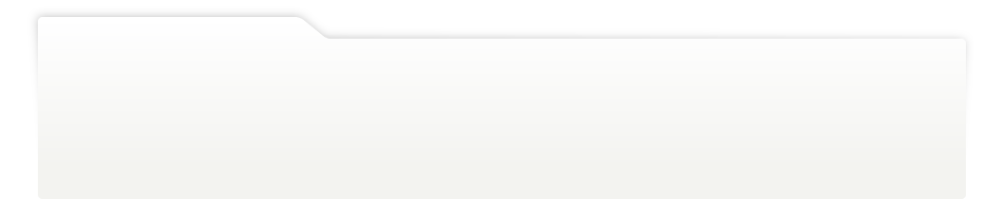
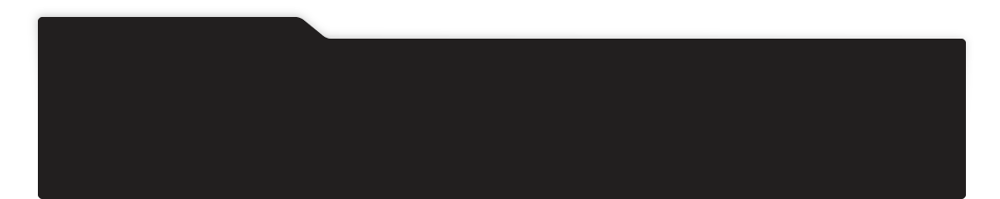
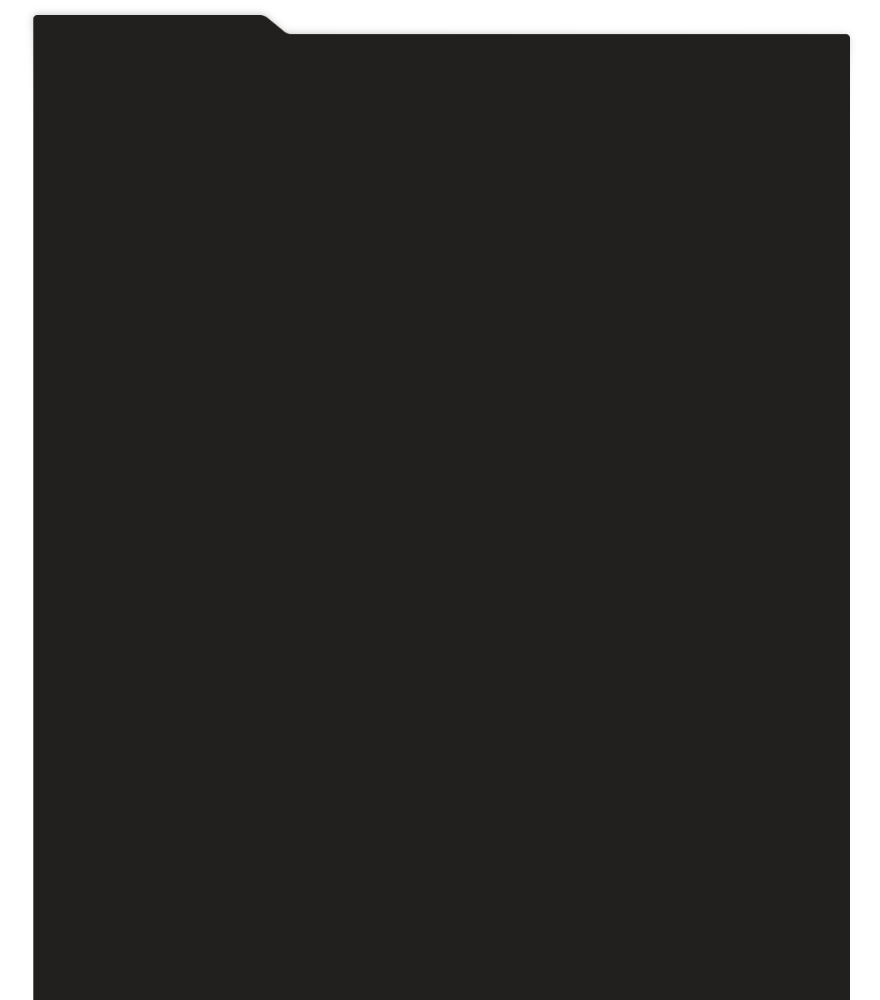
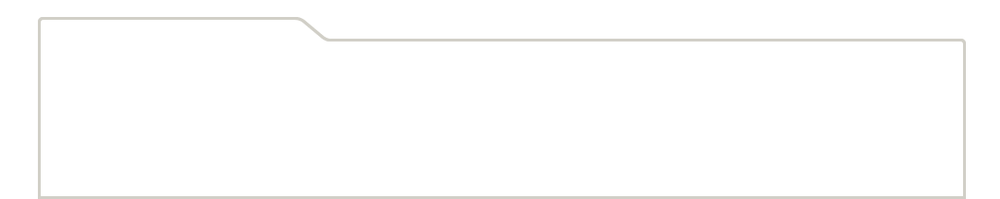
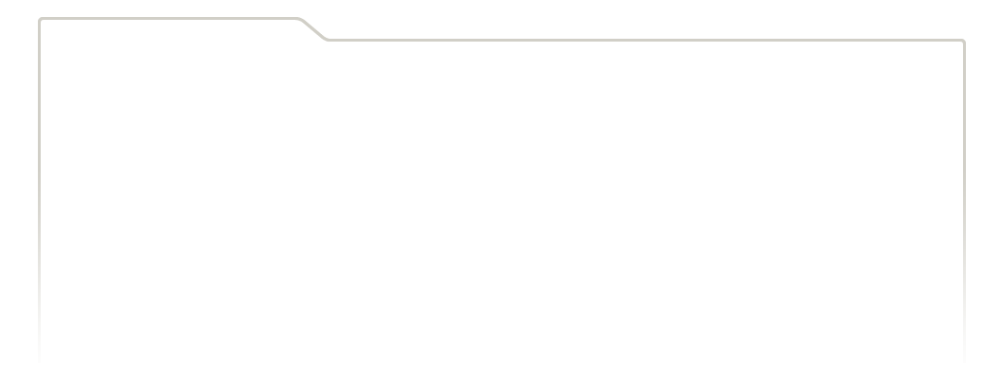
...
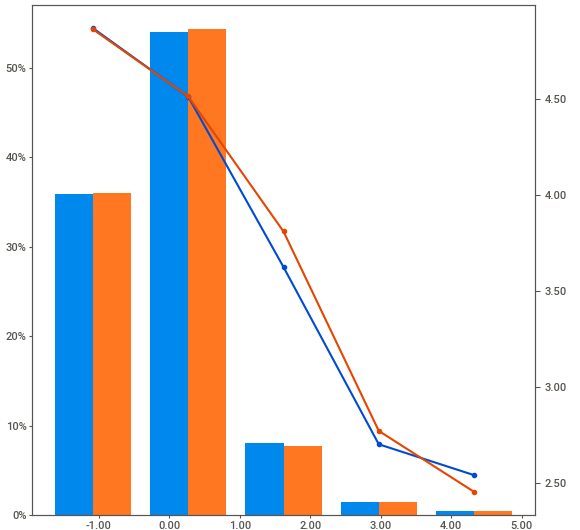
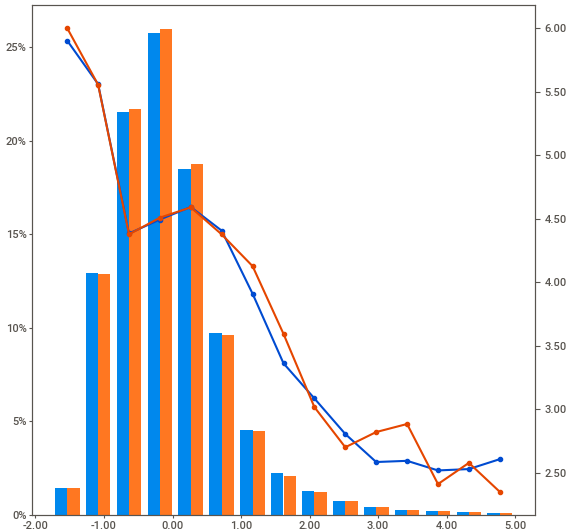
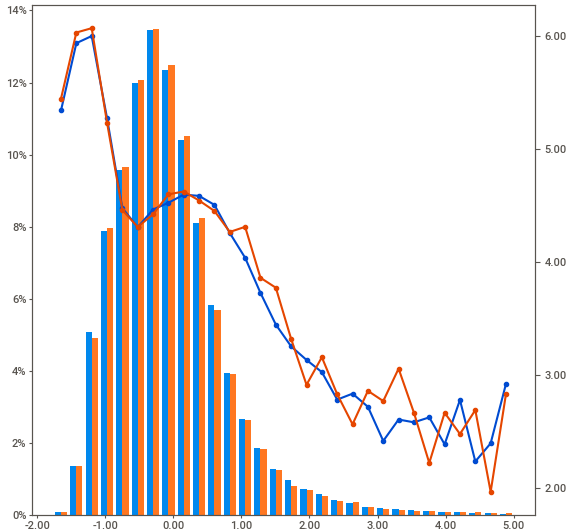
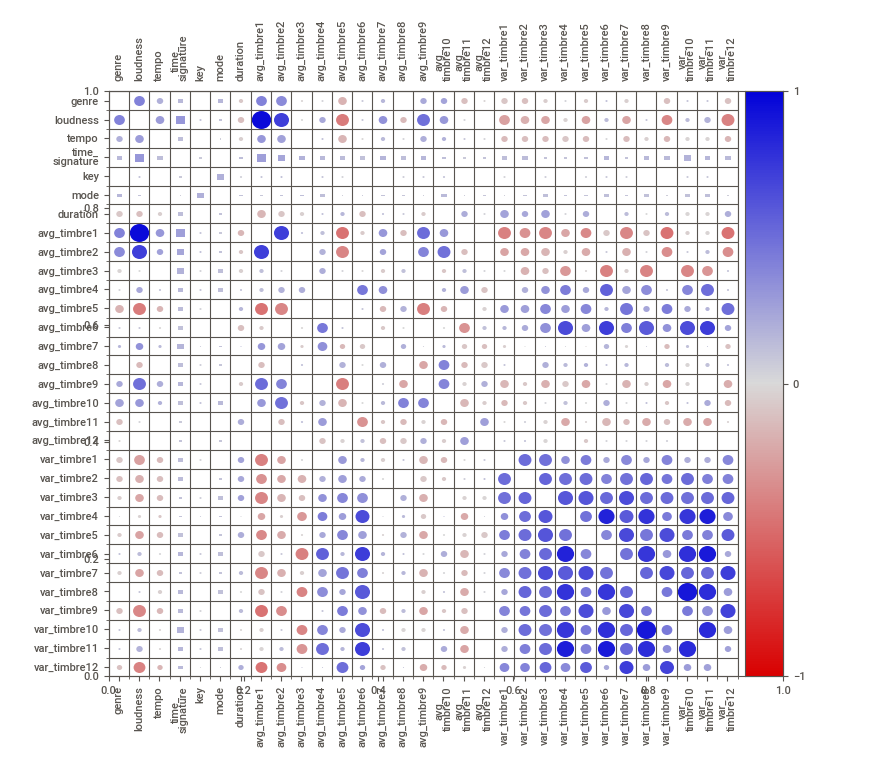
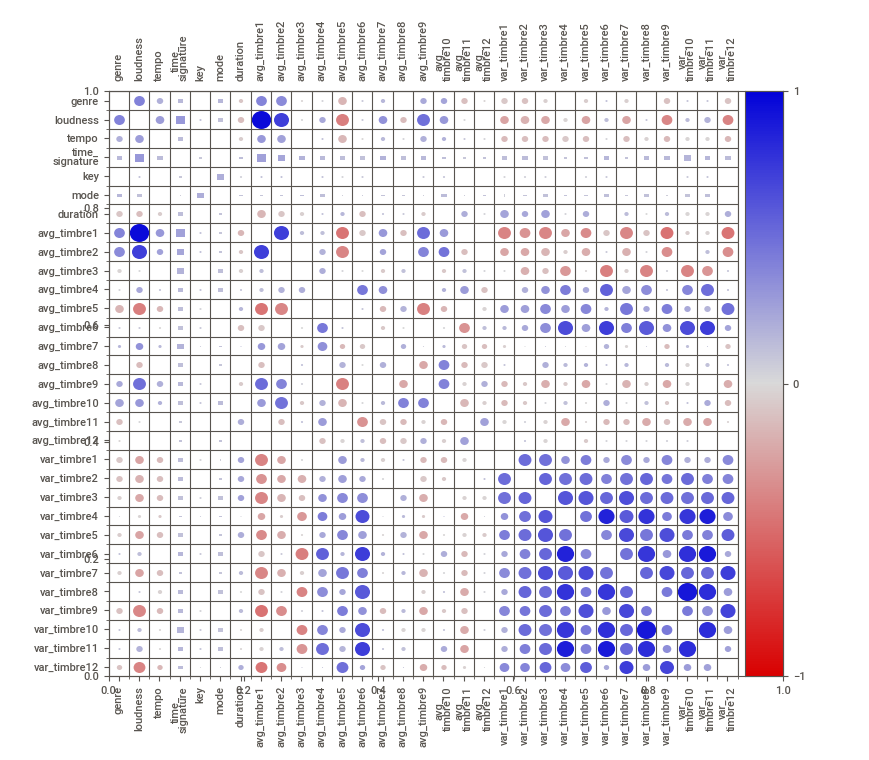

In [46]:
import sweetviz as sv

#analyzing the dataset
comparison_report = sv.compare([X_train, "Train"], [X_test, "Test"], target_feat="genre", feat_cfg=sv.FeatureConfig(force_num=['genre']))
comparison_report.show_notebook()